In [25]:
import polars as pl
import os
import numpy as np
import gc
from datetime import datetime
from tqdm import tqdm

base_path = './'
test_folders = ['1st_test', '2nd_test', '3rd_test']
output_features = 'extracted_features.parquet'
sampling_rate = 20000 

failure_map = {
    '1st_test': 'Bearing 3 (inner race), Bearing 4 (roller element)',
    '2nd_test': 'Bearing 1 (outer race)',
    '3rd_test': 'Bearing 3 (outer race)'
}

def get_spectral_features(amps, freqs):
    psd = amps**2 
    sum_psd = np.sum(psd)
    if sum_psd == 0: return 0, 0, 0
    
    spectral_centroid = np.sum(freqs * psd) / sum_psd
    rmsf = np.sqrt(np.sum((freqs**2) * psd) / sum_psd)
    spec_var = np.sum(((freqs - spectral_centroid)**2) * psd) / sum_psd
    return spectral_centroid, rmsf, spec_var

def extract_advanced_features():
    all_summaries = []
    for folder in test_folders:
        folder_path = os.path.join(base_path, folder)
        if not os.path.exists(folder_path): continue
        files = [f for f in sorted(os.listdir(folder_path)) if not f.startswith('.')]
        
        for filename in tqdm(files, desc=f"Processing {folder}"):
            try:
                ts_obj = datetime.strptime(filename, '%Y.%m.%d.%H.%M.%S')
                df = pl.read_csv(os.path.join(folder_path, filename), separator='\t', has_header=False)
                
                if folder == '1st_test':
                    df = df.select([pl.col("column_1").alias("1"), pl.col("column_3").alias("2"), 
                                    pl.col("column_5").alias("3"), pl.col("column_7").alias("4")])
                else:
                    df = df.select([pl.col(f"column_{i}").alias(str(i)) for i in range(1, 5)])
                
                for b in ["1", "2", "3", "4"]:
                    sig = df.get_column(b).to_numpy()
                    amps = np.abs(np.fft.rfft(sig))
                    freqs = np.fft.rfftfreq(len(sig), d=1/sampling_rate)
                    
                    peak_f = freqs[np.argmax(amps[1:]) + 1] 
                    sc, rmsf, s_var = get_spectral_features(amps, freqs)
                    
                    all_summaries.append({
                        "timestamp": ts_obj, "test": folder, "bearing": b,
                        "rms": np.sqrt(np.mean(sig**2)),
                        "kurtosis": pl.Series(sig).kurtosis(),
                        "peak_freq": peak_f,
                        "spec_centroid": sc, "rmsf": rmsf, "spec_var": s_var,
                        "failure_type": failure_map[folder]
                    })
            except Exception: continue
        gc.collect()
    pl.DataFrame(all_summaries).write_parquet(output_features)
    print(f"\nFeatures saved to {output_features}")

extract_advanced_features()

Processing 1st_test:   0%|          | 0/2156 [00:00<?, ?it/s]

Processing 3rd_test: 100%|██████████| 6324/6324 [03:25<00:00, 30.79it/s]



Features saved to extracted_features.parquet


In [36]:
import pandas as pd
from sklearn.preprocessing import StandardScaler

df = pd.read_parquet('extracted_features.parquet')
df['max_time'] = df.groupby('test')['timestamp'].transform('max')
df['time_to_failure'] = (df['max_time'] - df['timestamp']).dt.total_seconds() / 3600
df['target'] = (df['time_to_failure'] <= 3).astype(int)

# Updated to include new FFT features
features_to_scale = ['rms', 'kurtosis', 'peak_freq']
scaler = StandardScaler()
df[[f'{f}_z' for f in features_to_scale]] = scaler.fit_transform(df[features_to_scale])

print(f"Dataset prepared with {len(df)} rows.")

Dataset prepared with 37856 rows.


In [37]:
from sklearn.cluster import KMeans

healthy_mask = df.groupby('test')['timestamp'].transform(
    lambda x: (x > x.quantile(0.05)) & (x <= x.quantile(0.10))
)
features_z = [f'{f}_z' for f in features_to_scale]
healthy_df = df[healthy_mask][features_z]

kmeans = KMeans(n_clusters=1, n_init=10).fit(healthy_df)
normal_center = kmeans.cluster_centers_

def get_dist(row):
    point = row[features_z].values
    return np.linalg.norm(point - normal_center)

df['health_dist'] = df.apply(get_dist, axis=1)
print("K-Means distance feature 'health_dist' successfully created.")

K-Means distance feature 'health_dist' successfully created.


In [88]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

# Updated feature set
X = df[[f'{f}_z' for f in features_to_scale] + ['health_dist']]
y = df['target']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

clf = RandomForestClassifier(n_estimators=100, max_depth=10, class_weight='balanced', random_state=42)
clf.fit(X_train, y_train)

print("--- Model Performance ---")
print(classification_report(y_test, clf.predict(X_test)))

importances = pd.Series(clf.feature_importances_, index=X.columns).sort_values(ascending=False)
print("\nFeature Importances:")
print(importances)

--- Model Performance ---
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      7538
           1       0.68      0.79      0.73        34

    accuracy                           1.00      7572
   macro avg       0.84      0.90      0.86      7572
weighted avg       1.00      1.00      1.00      7572


Feature Importances:
health_dist    0.362616
rms_z          0.335896
peak_freq_z    0.253300
kurtosis_z     0.048189
dtype: float64


### Fourier Transform of Sample Vibration Data

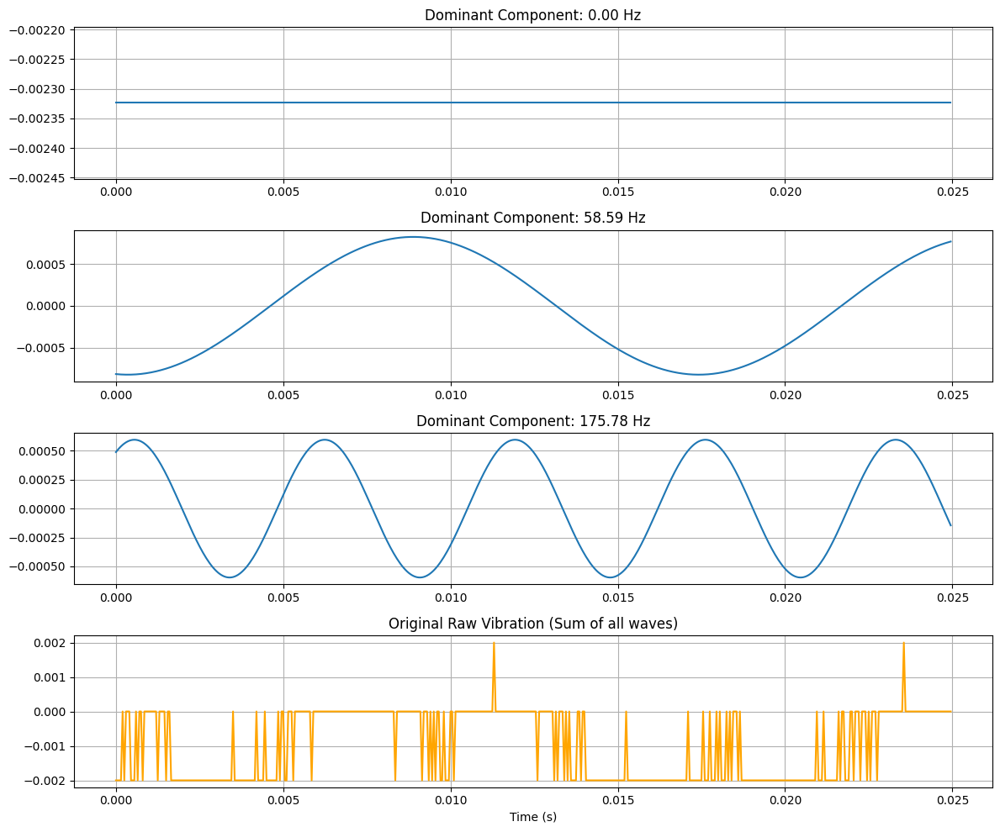

In [30]:
import numpy as np
import matplotlib.pyplot as plt
import polars as pl
import os

# 1. Load a single raw file instead of the giant parquet
# Picking a file from the 2nd test near the end (failure)
file_path = "2nd_test/2004.02.19.06.22.39" 
fs = 20000 

if not os.path.exists(file_path):
    print("File not found! Please check the filename in your 2nd_test folder.")
else:
    # Read raw data (Bearing 1 is column 1 in Set 2)
    raw_df = pl.read_csv(file_path, separator='\t', has_header=False)
    signal = raw_df['column_1'].to_numpy()
    t = np.linspace(0, len(signal)/fs, len(signal))

    # 2. Perform FFT
    fft_vals = np.fft.rfft(signal)
    freqs = np.fft.rfftfreq(len(signal), 1/fs)
    amplitudes = np.abs(fft_vals)

    # 3. Find top 3 dominant frequencies
    top_indices = np.argsort(amplitudes)[-3:][::-1]

    plt.figure(figsize=(12, 10))

    # Plot Individual Sine Waves (Zoomed in to see the oscillations)
    for i, idx in enumerate(top_indices):
        freq = freqs[idx]
        amp = amplitudes[idx] / len(signal) * 2
        phase = np.angle(fft_vals[idx])
        
        sine_wave = amp * np.cos(2 * np.pi * freq * t + phase)
        
        plt.subplot(4, 1, i+1)
        plt.plot(t[:500], sine_wave[:500]) 
        plt.title(f"Dominant Component: {freq:.2f} Hz")
        plt.grid(True)

    # Plot the Original Complex Signal
    plt.subplot(4, 1, 4)
    plt.plot(t[:500], signal[:500], color='orange')
    plt.title("Original Raw Vibration (Sum of all waves)")
    plt.xlabel("Time (s)")
    plt.grid(True)
    
    plt.tight_layout()
    plt.show()

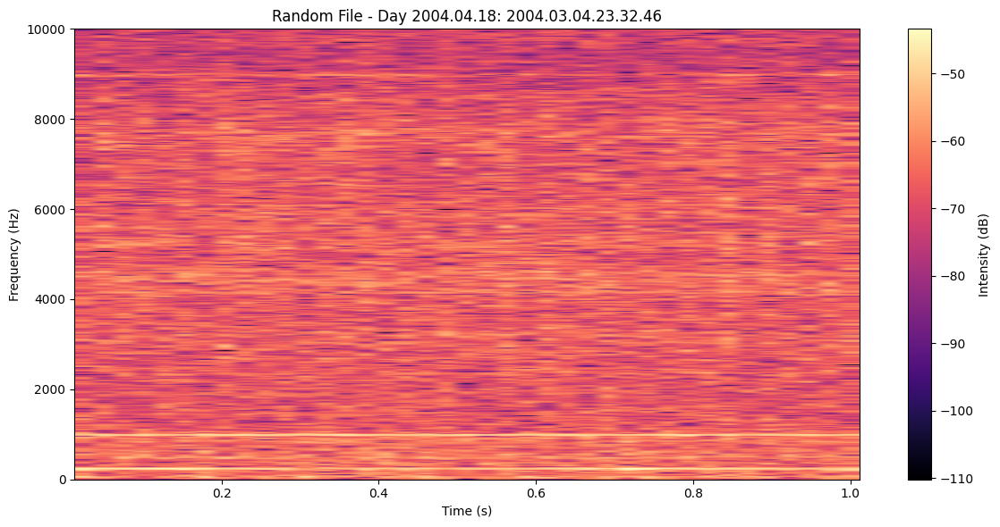

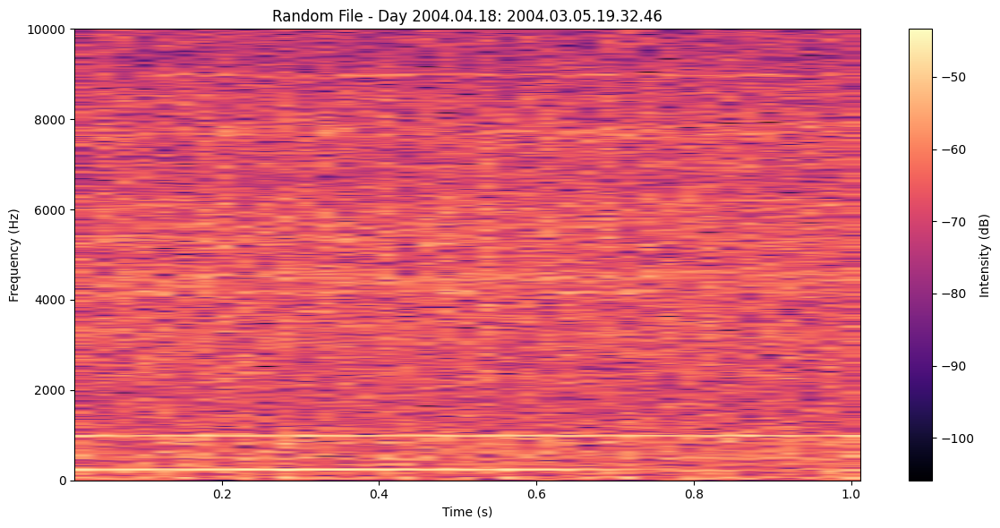

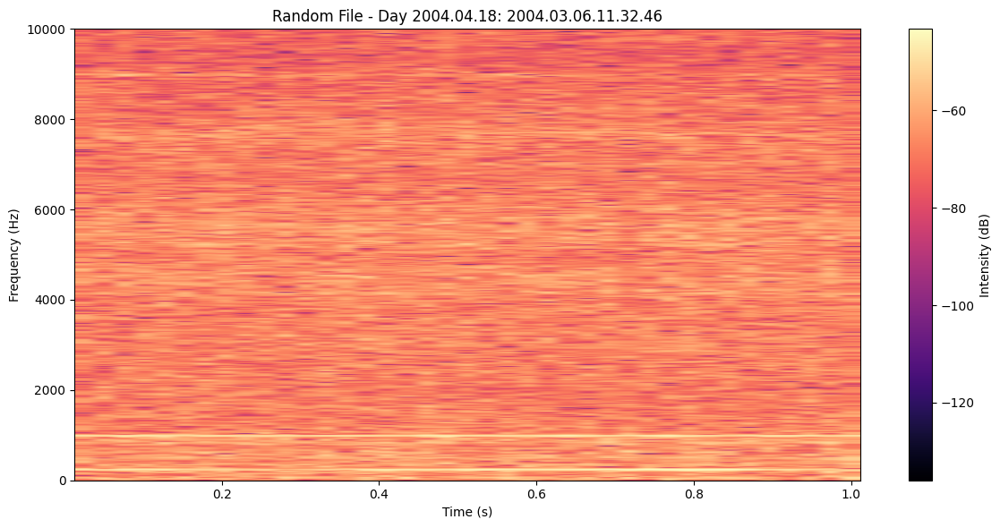

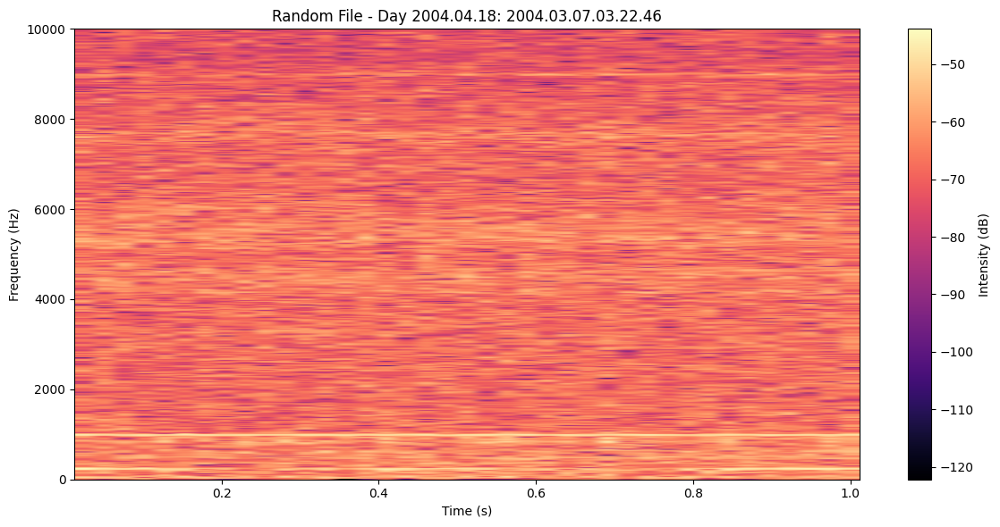

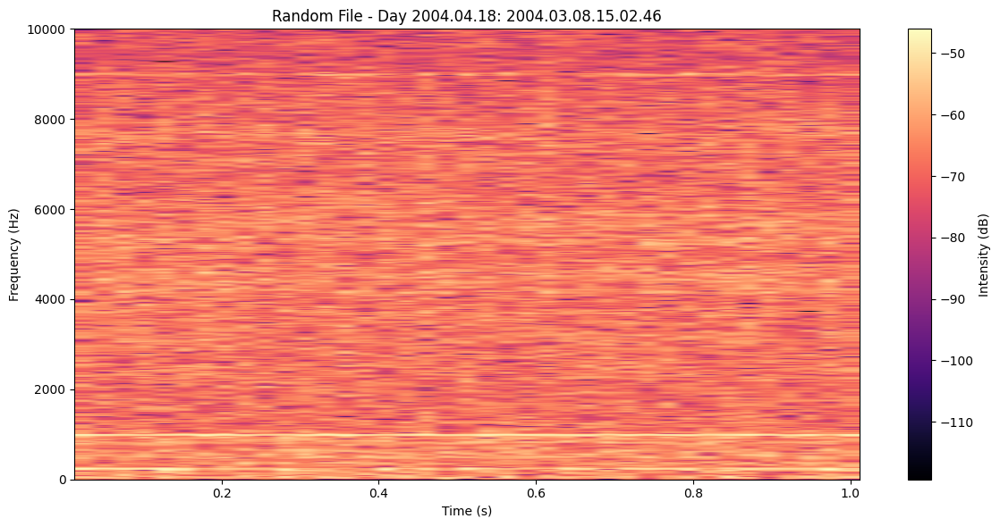

...

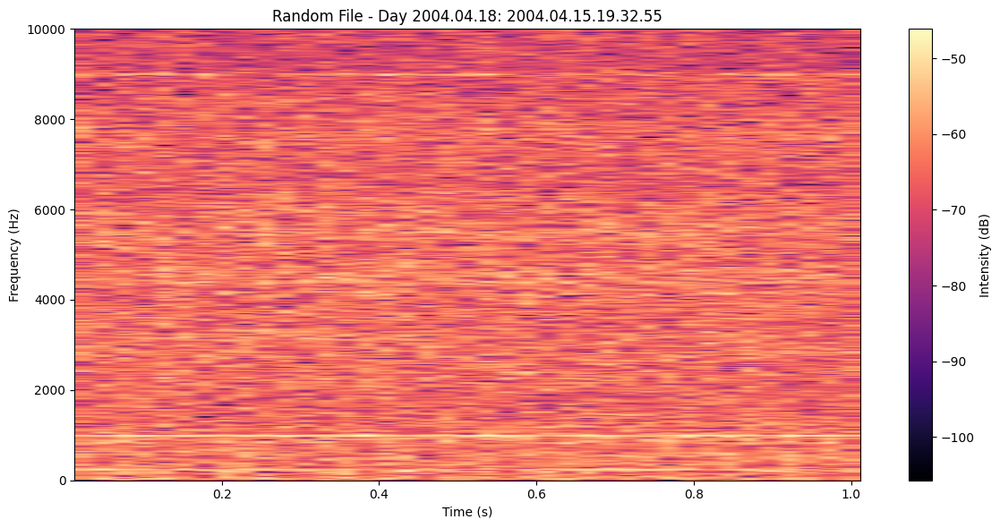

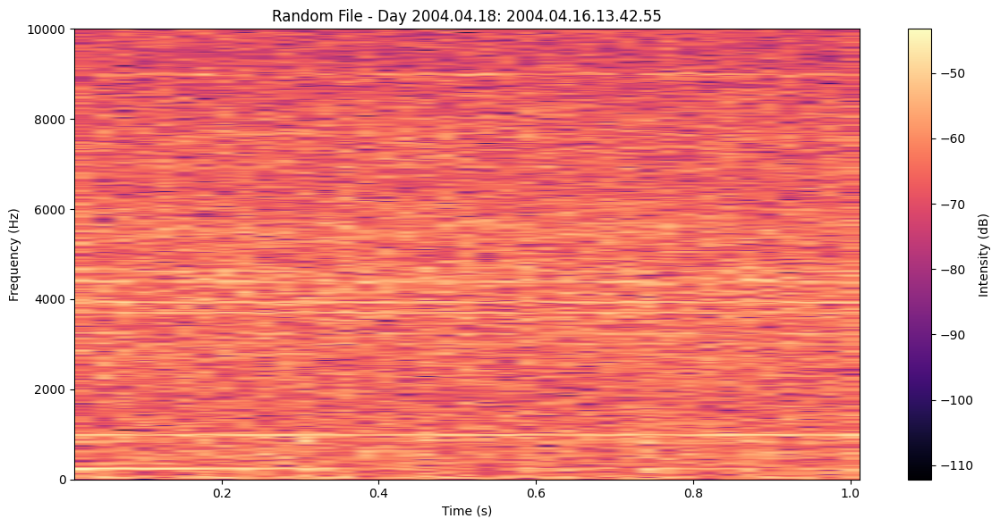

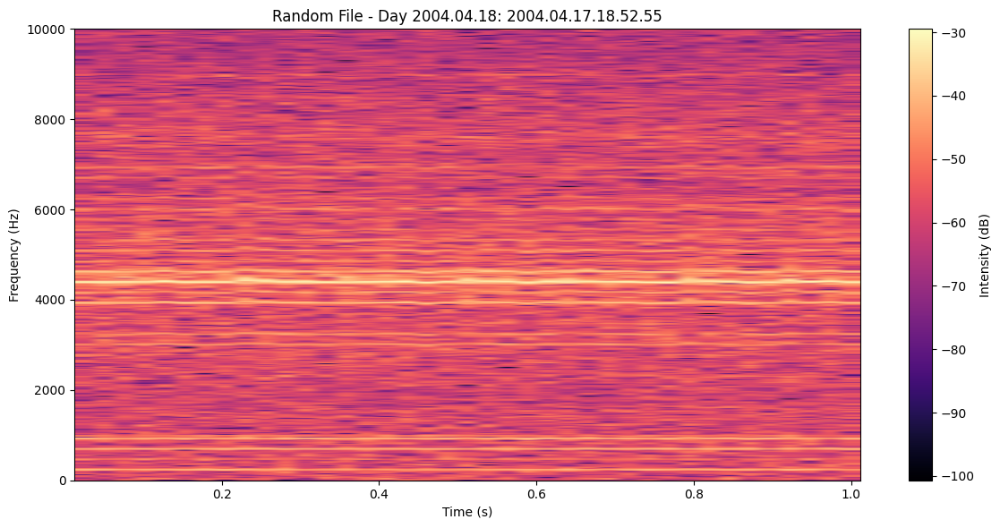

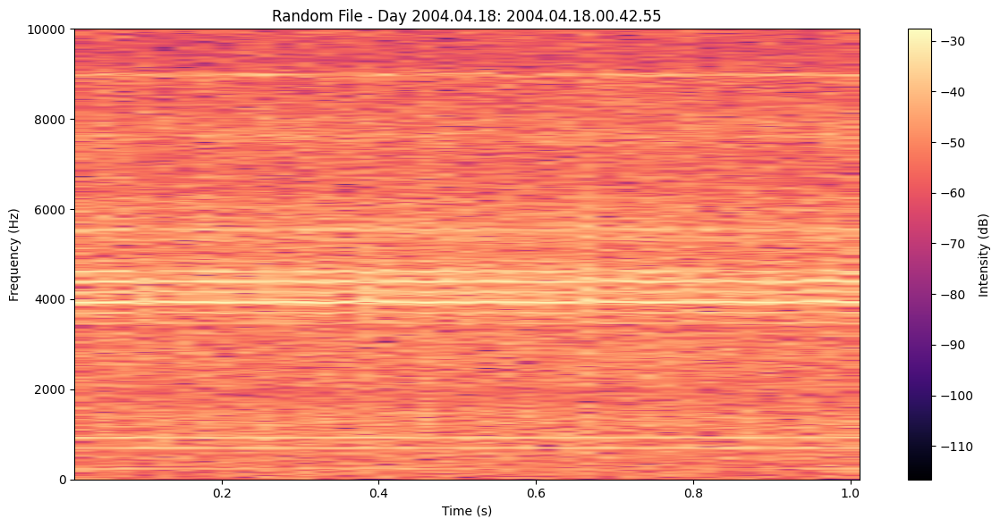

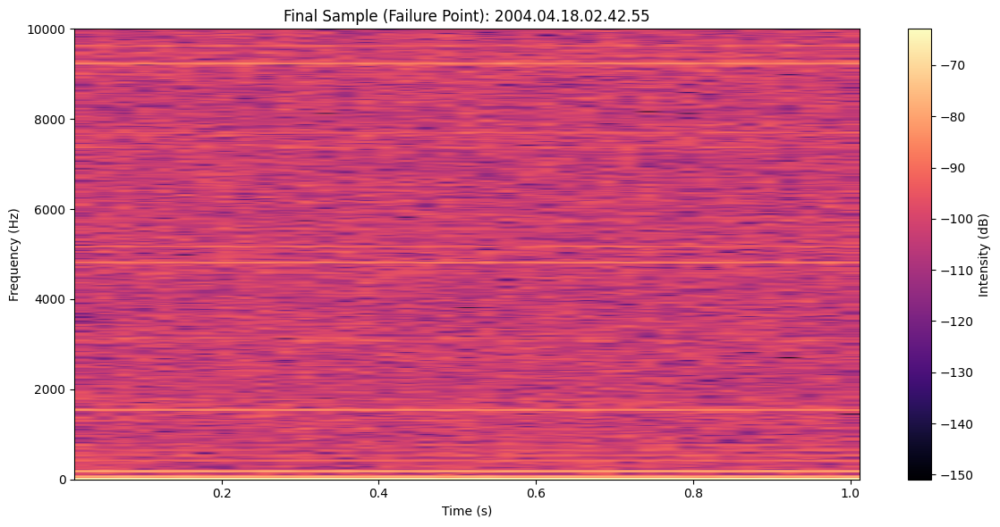

In [86]:
import numpy as np
import matplotlib.pyplot as plt
import polars as pl
import os
import random
from itertools import groupby

# 1. Configuration
folder_path = "3rd_test"
fs = 20000 

if not os.path.exists(folder_path):
    print("Folder not found!")
else:
    # 2. Group files by day (YYYY.MM.DD)
    all_files = sorted([f for f in os.listdir(folder_path)])
    selected_files = []
    
    # Grouping logic
    days_groups = []
    for day, group in groupby(all_files, key=lambda x: x[:10]):
        days_groups.append(list(group))

    # 3. Selection Logic
    for i, group in enumerate(days_groups):
        # Pick a random file from every day
        random_file = random.choice(group)
        selected_files.append((random_file, f"Random File - Day {day}"))
        
        # If it's the last day, also add the very last file
        if i == len(days_groups) - 1:
            last_file = group[-1]
            if last_file != random_file:  # Avoid duplicate plots if random picked the last one
                selected_files.append((last_file, "Final Sample (Failure Point)"))

    # 4. Generate Spectrograms
    for filename, label in selected_files:
        file_path = os.path.join(folder_path, filename)
        raw_df = pl.read_csv(file_path, separator='\t', has_header=False)
        signal = raw_df['column_3'].to_numpy()

        plt.figure(figsize=(12, 6))
        plt.specgram(signal, Fs=fs, NFFT=1024, noverlap=512, cmap='magma')
        
        plt.title(f"{label}: {filename}")
        plt.ylabel("Frequency (Hz)")
        plt.xlabel("Time (s)")
        plt.ylim(0, 10000)
        plt.colorbar(label="Intensity (dB)")
        plt.tight_layout()
        plt.show()

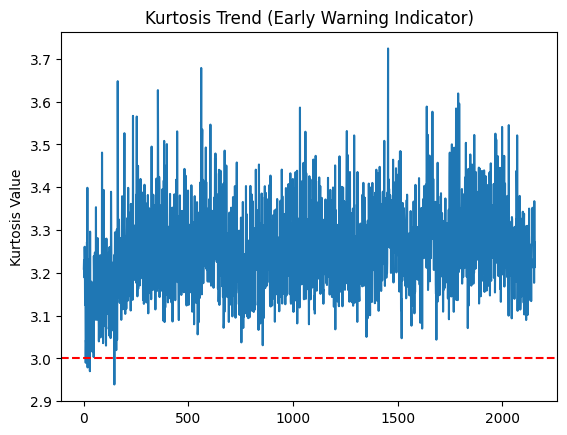

In [83]:
import scipy.stats as stats

results = []

for filename in sorted(os.listdir(folder_path)):
    path = os.path.join(folder_path, filename)
    data = pl.read_csv(path, separator='\t', has_header=False)['column_3'].to_numpy()
    
    # Kurtosis: > 3.0 indicates impulsive (impact) noise
    kurt = stats.kurtosis(data, fisher=False) 
    results.append(kurt)

plt.plot(results)
plt.axhline(y=3, color='r', linestyle='--', label='Baseline')
plt.title("Kurtosis Trend (Early Warning Indicator)")
plt.ylabel("Kurtosis Value")
plt.show()

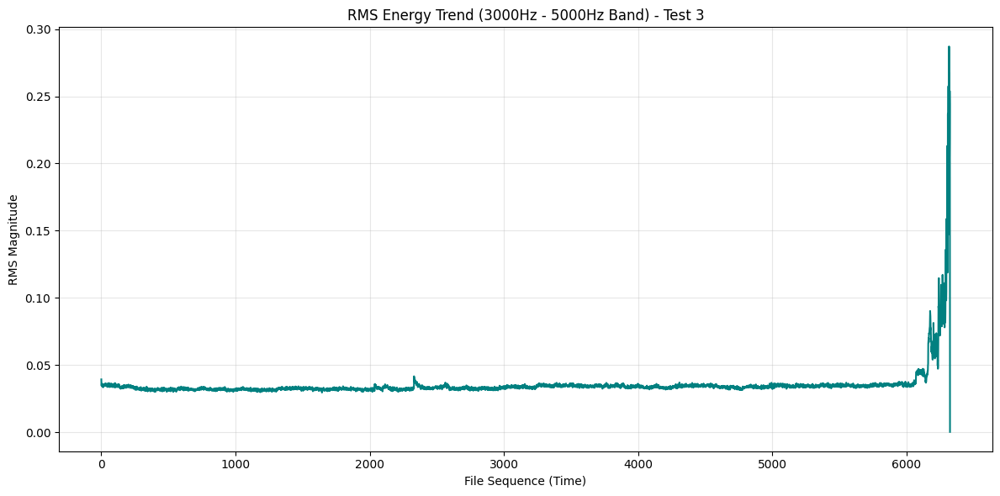

In [85]:
import numpy as np
import matplotlib.pyplot as plt
import polars as pl
import os
from scipy.signal import butter, filtfilt

# 1. Configuration
folder_path = "3rd_test"
fs = 20000
lowcut = 3000
highcut = 5000

# 2. Bandpass Filter & RMS Function
def get_bandpass_rms(data, lowcut, highcut, fs, order=4):
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    # Create a Butterworth bandpass filter
    b, a = butter(order, [low, high], btype='band')
    # Apply filter and calculate RMS of the filtered signal
    filtered_signal = filtfilt(b, a, data)
    return np.sqrt(np.mean(filtered_signal**2))

# 3. Processing Loop
all_files = sorted([f for f in os.listdir(folder_path) if f.startswith('2004')])
rms_trends = []

for filename in all_files:
    path = os.path.join(folder_path, filename)
    # Use column_1 for Bearing 1
    data = pl.read_csv(path, separator='\t', has_header=False)['column_4'].to_numpy()
    
    rms_val = get_bandpass_rms(data, lowcut, highcut, fs)
    rms_trends.append(rms_val)

# 4. Plotting the Trend
plt.figure(figsize=(12, 6))
plt.plot(rms_trends, color='teal', linewidth=1.5)
plt.title(f"RMS Energy Trend ({lowcut}Hz - {highcut}Hz Band) - Test 3")
plt.xlabel("File Sequence (Time)")
plt.ylabel("RMS Magnitude")
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

In [87]:
import numpy as np
import polars as pl
import os
from scipy.stats import kurtosis
from scipy.signal import butter, filtfilt
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score, classification_report

# 1. Feature Extraction Functions
def get_features(signal, fs=20000):
    # Kurtosis
    kurt = kurtosis(signal, fisher=False)
    
    # 4kHz - 8kHz Bandpass RMS
    nyq = 0.5 * fs
    b, a = butter(4, [4000/nyq, 8000/nyq], btype='band')
    filtered = filtfilt(b, a, signal)
    rms_band = np.sqrt(np.mean(filtered**2))
    
    return [kurt, rms_band]

# 2. Process Files
folder_path = "3rd_test"
files = sorted([f for f in os.listdir(folder_path) if f.startswith('2004')])
features_list = []
labels = []

# Labeling: We know the failure is at the end (last ~500 files as '1', others '0')
failure_threshold = len(files) - 500 

for i, filename in enumerate(files):
    path = os.path.join(folder_path, filename)
    data = pl.read_csv(path, separator='\t', has_header=False)['column_1'].to_numpy()
    
    features_list.append(get_features(data))
    labels.append(1 if i >= failure_threshold else 0)

# 3. Model Training
X = np.array(features_list)
y = np.array(labels)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

clf = RandomForestClassifier(n_estimators=100)
clf.fit(X_train, y_train)

# 4. Evaluation
y_pred = clf.predict(X_test)
score = f1_score(y_test, y_pred)

print(f"F1 Score: {score:.4f}")
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

F1 Score: 0.5303

Classification Report:
              precision    recall  f1-score   support

           0       0.95      0.98      0.96      1738
           1       0.67      0.44      0.53       160

    accuracy                           0.93      1898
   macro avg       0.81      0.71      0.75      1898
weighted avg       0.93      0.93      0.93      1898

